<a href="https://colab.research.google.com/github/SudeepSarkar/sarkar-computer-vision-lectures/blob/main/CV_Module_9_2_Tracking_People_Video.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

(c) Copyright Sudeep Sarkar, University of South Florida, 2021

# Motion tracking video

You will learn about

* Tracking in video.
* Kalman tracking that allows for the use of a prior motion model to constrain the tracks and estimation of state parameters that are not directly observable, such as velocity, acceleration, etc.


Relevant chapters in the textbook

* 7.1.5 Feature tracking
* 9.4.4 Video object tracking

# Useful prior code


## Standard Imports

In [1]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import scipy.ndimage as scimage
import torch.nn as nn
from skimage import io
from skimage.feature import peak_local_max

#!pip install opencv-contrib-python
import cv2
print (cv2 .__version__)

!pip install xmltodict
import xmltodict
from scipy.spatial.transform import Rotation

np.set_printoptions(precision=2)

4.8.0


## Mount Google drive

In [2]:
from google.colab import drive
drive.mount('/content/drive')
data_dir = '/content/drive/MyDrive/Colab Notebooks/CAP 6415 Computer Vision Online/data/'

Mounted at /content/drive


## Code to display error ellipses

In [3]:
from matplotlib.patches import Ellipse
import matplotlib.transforms as transforms
# This function was taken/adapted from https://matplotlib.org/devdocs/gallery/statistics/confidence_ellipse.html
def confidence_ellipse(cov, mu, ax, n_std=1.0, facecolor='none', **kwargs):
    """
    Create a plot of the covariance confidence ellipse
    Parameters
    ----------
    cov : 2 by 2 covariance matrix
        Input data.
    n_std : float
        The number of standard deviations to determine the ellipse's radiuses.
    **kwargs
        Forwarded to `~matplotlib.patches.Ellipse`
    Returns
    -------
    Ellipse
    """
    pearson = cov[0, 1]/np.sqrt(cov[0, 0] * cov[1, 1])
    # Using a special case to obtain the eigenvalues of this
    # two-dimensionl dataset.
    ell_radius_x = np.sqrt(1 + pearson)
    ell_radius_y = np.sqrt(1 - pearson)
    ellipse = Ellipse((0, 0), width=ell_radius_x * 2, height=ell_radius_y * 2,
                      facecolor=facecolor, **kwargs)
    # Calculating the stdandard deviation of x from
    # the squareroot of the variance and multiplying
    # with the given number of standard deviations.
    scale_x = np.sqrt(cov[0, 0]) * n_std
    mean_x = mu[0]
    # calculating the stdandard deviation of y ...
    scale_y = np.sqrt(cov[1, 1]) * n_std
    mean_y = mu[1]
    transf = transforms.Affine2D() \
        .rotate_deg(45) \
        .scale(scale_x, scale_y) \
        .translate(mean_x, mean_y)
    ellipse.set_transform(transf + ax.transData)
    return ellipse

# Detection of persons in a video (measurement)

We will look at a deep learning approach to detect persons in frames of a video. We outline each person using a bounding box. These detected persons will form our **measurements**.

* We will use an object class to process video frames.

* We will use a second object class to manage the bounding boxes (bboxes) tracked through the video.

* We accomplish the actual detection of persons using the Single Shot Detector (SSD) that we studied in one of the earlier lectures.

## Code: `resize_image`

This is a helper code used to resize images. Most deep learning code accepts images of specific sizes. For example, the Single Shot Detector (SSD) that we will use has been trained with 300 by 300 sized images. Its weights have been tuned to process objects at that scale. If we provide it with high-resolution images, which our cameras output, it will not produce the best results. We need to downsample the image resolution to 300 by 300. We could have used the OpenCV or other image resizing code. However, most of the off-the-shelf image resizing code will change the image's aspect if the original high-resolution image is not square. That is, it will stretch the image in one of the dimensions. The objects will look either longer or wider.

We need a method that will preserve the aspect of the image, hence, this function. It zero-pads the high-resolution input image horizontally or vertically to make it a square and then downsamples it. The output image is a smaller version of the original image, with black bands in it. We will see some examples a few cells down.

In [4]:
def resize_image (frame, img_col, img_row) :
    # Resize image (frame) to (img_row, img_col) with black borders, if needed
    # The aspect ratio of the image does not change, i.e. the underlying image is
    # not stretched in any direction.
    # returns the resized image.
    border_v = 0
    border_h = 0
    aspect = img_col/img_row
    if (aspect >= (frame.shape[0]/frame.shape[1])) :
        border_v = int(((aspect*frame.shape[1])-frame.shape[0])/2)
    else:
        border_h = int(((aspect*frame.shape[0])-frame.shape[1])/2)
    frame_resized = cv2.copyMakeBorder(frame, border_v, border_v, border_h, border_h, cv2.BORDER_CONSTANT, 0)
    frame_resized = cv2.resize(frame_resized, (img_row, img_col))
    return (frame_resized)

## Code: Class `video_stream`



In [12]:
class video_stream:
    '''
    Object class to start and interact with a video stream or file
    '''
    def __init__(self, video_source):
        self.cap = cv2.VideoCapture(video_source)  # Open video file
        if (self.cap.isOpened()== False):
            print("Error opening video stream or file")
        else :
            self.i = 0   # variable to keep track of the frame number read
            self.skip = 0 # number of frames to skip during each call to "next" method.
    #---------------------------------------------------------------------------
    def set_skip(self, n) :
        self.skip = n
    #---------------------------------------------------------------------------
    def next (self) :
        # reads and stores frame AFTER skipping "skip" number of frames
        # if skip = 0 -- reads net frame
        for k in range(self.skip): # skip  frames
            ret, self.next_frame = self.cap.read()
            if ret == True:
                self.i = self.i + 1

        ret, self.next_frame = self.cap.read()
        if ret == True:
            self.i = self.i + 1
            return (self.next_frame)
        else:
            return ([])
    #---------------------------------------------------------------------------
    def resize_save_frame (self, framedir, width, height) :
        # resize the current frame in self.next_frame to (width, height) and save to file named with the frame number,
        # in the directory "framedir". The resizing operations does not change the aspect ratio of the image.
        self.frame_reduced = resize_image (self.next_frame, 300, 300)
        file_name = frame_dir+'frame{:04d}.png'.format(self.i)
        cv2.imwrite (file_name, self.frame_reduced)
        return (file_name, self.frame_reduced)
    #---------------------------------------------------------------------------
    def close (self) :
        self.cap.release()
    #---------------------------------------------------------------------------

    def frame_number (self) :
        # returns current frame number read
        return (self.i)
    #---------------------------------------------------------------------------
    def current_frame (self) :
        # returns current frame
        return (self.next_frame)
    #---------------------------------------------------------------------------
    def inside_frame (self, x, y) :
        # returns current frame
        return (((x >=0) and (y >= 0) and
                 (x < self.next_frame.shape[1]) and
                 (y < self.next_frame.shape[0])))
    #---------------------------------------------------------------------------


## Code: Demo video class

Image file reduced to (300, 300) and saved in  /content/drive/MyDrive/Colab Notebooks/CAP 6415 Computer Vision Online/data/Wildtrack/C1/frame0016.png
Image file reduced to (300, 300) and saved in  /content/drive/MyDrive/Colab Notebooks/CAP 6415 Computer Vision Online/data/Wildtrack/C1/frame0032.png
Image file reduced to (300, 300) and saved in  /content/drive/MyDrive/Colab Notebooks/CAP 6415 Computer Vision Online/data/Wildtrack/C1/frame0048.png


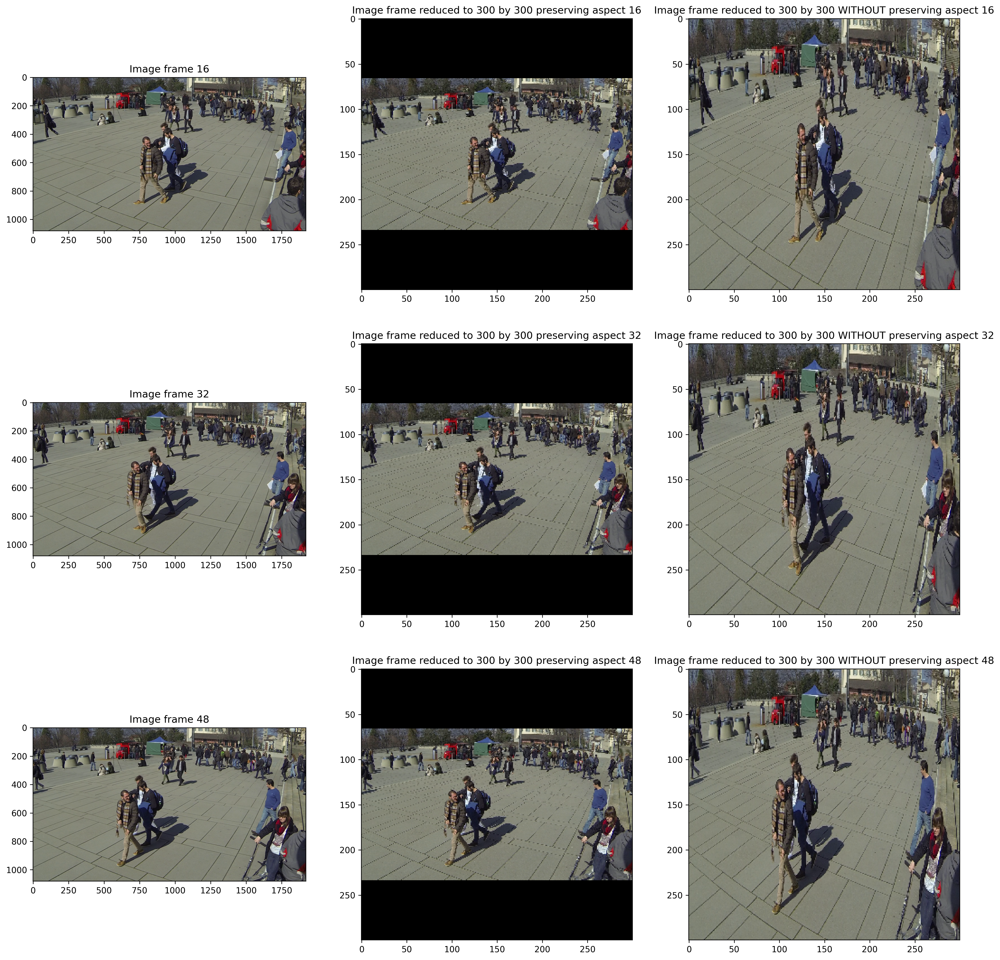

In [19]:
# Get videos from https://www.epfl.ch/labs/cvlab/data/data-wildtrack/
video_file = data_dir + 'Wildtrack/C1/cam1.mp4'
frame_dir = data_dir + 'Wildtrack/C1/'

video = video_stream (video_file)
video.set_skip (n=15)
plt.figure (figsize=(20, 20), dpi=300)
for i in range (3) :
    plt.subplot(3,3,3*i+1)
    next_frame = video.next()
    plt.imshow(cv2.cvtColor(next_frame, cv2.COLOR_BGR2RGB))
    plt.title('Image frame {}'.format(video.frame_number()))

    filename, frame_small = video.resize_save_frame (frame_dir, 300, 300)
    print('Image file reduced to (300, 300) and saved in ', filename)
    plt.subplot(3,3,3*i+2)
    plt.imshow(cv2.cvtColor(frame_small, cv2.COLOR_BGR2RGB))
    plt.title('Image frame reduced to 300 by 300 preserving aspect {}'.format(video.frame_number()))

    frame_resized = cv2.resize(next_frame, (300, 300))
    plt.subplot(3,3,3*i+3)
    plt.imshow(cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB))
    plt.title('Image frame reduced to 300 by 300 WITHOUT preserving aspect {}'.format(video.frame_number()))

video.close ()

## Code: Class bboxes

In [20]:
class bounding_boxes :
    '''
    methods and attributes related to processing bounding boxes (stored in numpy format)
    '''
    def __init__(self, bbox = [], fmt = 'xyxy'):
        if type(bbox) is list :
            self.bboxes_center = [] # stores the bounding boxes (N by 4 by 1 array)  in center format (cx, cy, width, height)
            self.bboxes_corners = [] # stores the top-left and bottom-right corners of the bounding boxes: (x1, y1, x2, y2) (N by 4 by 1 array)
            self.N = 0 # number of bounding boxes
            self.scale = 1
            self.bboximage = [] # not used currently
            # could store the subimage snippet corresponding to the bboxes here,
            # list of sub-images (cv2 format)

        else :
            if fmt == 'xyxy' :
                self.set_corners_rep (bbox)
            else:
                self.set_center_rep (bbox)

    #---------------------------------------------------------------------------
    def count (self) :
        return (self.N)
    #-------------------------------------------------------------------------------
    def keep_tall_aspect (self) :
        # remove bounding boxes that are wider than they are tall, e.g. for standing person.
        self.get_center_rep () # compute center-based representation
        tall_logic = (self.bboxes_center[:,2,0] < self.bboxes_center[:,3,0]) # width < height
        self.bboxes_center = self.bboxes_center[tall_logic,:,:]
        self.bboxes_corners = self.bboxes_corners[tall_logic,:,:]
        self.N = np.sum(tall_logic)

    #-------------------------------------------------------------------------------
    def keep_wide_aspect (self) :
        # remove bounding boxes that are taller than they are wide
        self.get_center_rep () # compute center-based representation
        wide_logic = (self.bboxes_center[:,2,0] > self.bboxes_center[:,3,0]) # width > height
        self.bboxes_center = self.bboxes_center[wide_logic,:,:]
        self.bboxes_corners = self.bboxes_corners[wide_logic,:,:]
        self.N = np.sum(wide_logic)

    #-------------------------------------------------------------------------------
    def get_corners_rep (self) :
        # returns the bboxes (N by 4 by 1 array) in corners format  (x1, y1, x2, y2)
        if type(self.bboxes_corners) is list: # compute the corners_rep if not already computed, i.e. empty list
            A = np.array ([ [1, 0, -0.5, 0],
                            [0, 1, 0, -0.5],
                            [1, 0,  0.5, 0],
                            [0, 1,  0, 0.5]])
            self.bboxes_corners = (A @ self.bboxes_center)
        return (self.bboxes_corners)


    #-------------------------------------------------------------------------------
    def get_center_rep (self) :
        # returns the bboxes (N by 4 by 1 array) in center format (cx, cy, width, height)
        if type(self.bboxes_center) is list:
            B = np.array ([ [0.5, 0, 0.5, 0],
                            [0, 0.5, 0, 0.5],
                            [-1, 0,  1,   0],
                            [0, -1,  0,   1]])
            self.bboxes_center = (B @ self.bboxes_corners)
        return (self.bboxes_center)

    #-------------------------------------------------------------------------------
    def set_corners_rep (self, bboxes) :
        # Dimension of bboxes need to be n by 4 by 1, even for only one bbox, for which it needs to be 1 by 4 by 1
        if (len(bboxes.shape) == 3) and (bboxes.shape[1] == 4) and (bboxes.shape[2] == 1) :
            self.N = bboxes.shape[0]
            self.bboxes_corners = bboxes
            self.bboxes_center = []  # center rep need to be recomputed, if needed
        else :
            print('bboxes need to be 3 dimensional: (n, 4, 1). We have bboxes of dimension:', bboxes.shape)

    #-------------------------------------------------------------------------------
    def set_center_rep (self, bboxes) :
        # Dimension of bboxes need to be n by 4 by 1, even for only one bbox, for which it needs to be 1 by 4 by 1
        if (len(bboxes.shape) == 3) and (bboxes.shape[1] == 4) and (bboxes.shape[2] == 1) :
            self.N = bboxes.shape[0]
            self.bboxes_center = bboxes
            self.bboxes_corners = []  # corner rep need to be recomputed, if needed
        else :
            print('bboxes need to be 3 dimensional: (n, 4, 1). We have bboxes of dimension:', bboxes.shape)

    #-------------------------------------------------------------------------------
    def resize_bboxes (self, image_shape) :
        # returns bboxes scaled to image_shape size
        # It assumes the bboxes are with respect to a square image
        # These now needs to scaled to "image_shape".
        # The scaling has to respect the square aspect retio

        if type(self.bboxes_corners) is list:  # compute the corners representation if not computed already, i.e.
            self.get_corner_rep ()

        self.bboxes_center = [] # reset center representation, center rep need to be recomputed for the news scaled bboxes, if needed

        # Figure out the new scale of the bounding boxes.
        # The current scale is stored in self.scale, for which the default is 1
        height, width = image_shape
        new_scale = np.max([width, height])
        self.bboxes_corners = self.bboxes_corners * new_scale/self.scale # scale the corners

        # Shift the corner coordinates to account for non-square aspect
        if (width > height) : # to adjust for shift due to the black band
            self.bboxes_corners[:,1,0] = self.bboxes_corners[:,1,0] - (width-height)/2  # adjust the y coordinates
            self.bboxes_corners[:,3,0] = self.bboxes_corners[:,3,0] - (width-height)/2
        else :
            self.bboxes_corners[:,0,0] = self.bboxes_corners[:,0,0] - (height-width)/2  # adjust the y coordinates
            self.bboxes_corners[:,2,0] = self.bboxes_corners[:,2,0] - (height-width)/2

        self.scale = new_scale

    #-------------------------------------------------------------------------------
    def draw (self, ax, frame, color) :
        if type(frame) is not list:
            # if there is an image frame to be displayed
            # Show original, denormalized intensity image that was input to the SSD
            img_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            ax.imshow(img_rgb)
            ax.set_xlim(ax.get_xlim ())
            ax.set_ylim(ax.get_ylim ())

        # overlay bounding box from previous frame
        self.get_center_rep () # compute center representation, if it does not exist
        for i in range (self.N) :
            cx, cy, w, h = self.bboxes_center[i,:,0].astype(int)
            if (w > 0) :
                rect2 = patches.Rectangle((cx-w/2, cy-h/2), w, h, linewidth=4, edgecolor=color, facecolor='none')
                ax.add_patch(rect2)

    #-------------------------------------------------------------------------------
    def find_matching_bbox (self, given_boxes, iou_th=0.2) :
        # Find the bounding boxes that matches the (multiple) given_boxes using Jaccard Index (IOU)
        # https://pytorch.org/vision/main/generated/torchvision.ops.box_iou.html
        # given_boxes -- np.array of dimension (batch_size, 4, 1)
        # returns a (batch_size, 4, 1) np.array of matched bounding boxes
        # If no overlapping bounding box is found for any corresponding "given_box", it returns a bbox with [-100,-100,-100,-100],
        # the bboxes are in xyxy format

        iou = torchvision.ops.box_iou (torch.FloatTensor(given_boxes.squeeze(2)),
                                       torch.FloatTensor(self.bboxes_corners).squeeze())
        # Both sets of boxes are expected to be in (x1, y1, x2, y2) format with 0 <= x1 < x2 and 0 <= y1 < y2.
        #      boxes1 (Tensor[N, 4]) – first set of boxes
        #      boxes2 (Tensor[M, 4]) – second set of boxes
        # Returns
        #      the NxM matrix containing the pairwise IoU values for every element in boxes1 and boxes2

        # https://docs.scipy.org/doc/scipy-0.18.1/reference/generated/scipy.optimize.linear_sum_assignment.html
        # The linear sum assignment problem is also known as minimum weight matching in bipartite graphs.
        # A problem instance is described by a matrix C, where each C[i,j] is the cost of matching
        # vertex i of the first partite set (a “worker”) and vertex j of the second set (a “job”).
        # The goal is to find a complete assignment of workers to jobs of minimal cost.
        print('IOU:', iou.numpy())

        from scipy.optimize import linear_sum_assignment
        row_ind, col_ind = linear_sum_assignment(-iou.numpy())
        max_iou = iou[row_ind, col_ind]
        #print('IOU:', iou, '\n row_ind', row_ind, 'col_ind', col_ind, '\n max_iou:', max_iou)
        out = self.bboxes_corners[col_ind,:,:]

        # Only update with bounding boxes with sufficient IOU with current one.
        # if the IOU is < iou_th for a given_box in the batch then return a bbox
        # with [-100, -100, -200, -200] as the corresponding entry
        index = (max_iou.numpy() < iou_th)
        out[index, :, 0] = [-100, -100, -200, -200] #given_boxes[index, :, :]


        return (out, max_iou)


## Code: Class -- SSD300 -- Computing bounding boxes using Single Shot Detector model from NVIDIA

* This SSD300 model is based on the SSD: Single Shot MultiBox Detector paper, which describes SSD as “a method for detecting objects in images using a single deep neural network”. The input size is fixed to 300x300.

* https://pytorch.org/hub/nvidia_deeplearningexamples_ssd/

* The main difference between this model and the one described in the paper is in the backbone. Specifically, the VGG model is obsolete and is replaced by the ResNet-50 model.

* The **COCO dataset** is an excellent object detection dataset with 80 classes, 80,000 training images and 40,000 validation images. https://cocodataset.org/#home

In [21]:
import torchvision
class SSD300:
    def __init__(self, obj_label):
        # Load an SSD model pretrained on COCO dataset,
        # as well as a set of utility methods for convenient and comprehensive formatting
        # of input and output of the model.
        self.ssd_model = torch.hub.load('NVIDIA/DeepLearningExamples:torchhub', 'nvidia_ssd', trust_repo='True')
        self.utils = torch.hub.load('NVIDIA/DeepLearningExamples:torchhub', 'nvidia_ssd_processing_utils', trust_repo='True')
        self.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        print('Computing on: ', self.device)
        self.ssd_model.to(self.device)
        self.ssd_model.eval()

        # The model was trained on COCO dataset, which we need to access in order to
        # translate 80 class IDs into object names. For the first time,
        # downloading annotations may take a while.
        self.classes_to_labels = self.utils.get_coco_object_dictionary() # get COCO label strings

        # Explore the COCO website: https://cocodataset.org/#home

        # store the ssd_if of the object label under consideration that is passed using obj_label,
        # for example for obj_label = 'person', the self.selected_class is 1
        self.selected_class = self.classes_to_labels.index(obj_label) + 1

    #--------------------------------------------------------------------------
    def compute_bboxes (self, file_name, verbose=False):
        # detect objects in the reduced sized images.
        # returned bboxes coordinates (in xyxy format) are between 0 and 1

        # Format the images to comply with the network input and convert them to tensor.
        inputs = [self.utils.prepare_input(file_name)]
        tensor = self.utils.prepare_tensor(inputs)

        # Run the SSD network to perform object detection.
        with torch.no_grad():
            detections_batch = self.ssd_model(tensor)
        if verbose :
            print('\nSSD output is a tuple of {} entries of sizes (batch_size, (bbox or classes), number) = {}, {}'.format(len(detections_batch), detections_batch[0].shape, detections_batch[1].shape))

        # By default, raw output from SSD network per input image contains 8732 boxes
        # with localization and class probability distribution. Let’s filter this output
        # to only get reasonable detections (confidence>40%) in a more comprehensive format.
        results_per_input = self.utils.decode_results(detections_batch) # rearranges the output, which has different components, bboxes, labels, confidences
        if verbose :
            print('\nAfter filtering out the background labels we have tuple of {} images, {} output types (bboxes, labels, confidence)'.format(len(results_per_input), len(results_per_input[0])))
            print(' The output shapes are', results_per_input[0][0].shape, results_per_input[0][1].shape, results_per_input[0][2].shape)

        # select the most confident ones -- change 0.4 below to see the effect
        best_results_per_input = [self.utils.pick_best(results, 0.4) for results in results_per_input] # picks the confident inferences
        if verbose :
            print('\nAfter filtering weak labels we have tuple of {} images, {} output types (bboxes, labels, confidence)'.format(len(best_results_per_input), len(best_results_per_input[0])))
            print(' The output shapes are', best_results_per_input[0][0].shape, best_results_per_input[0][1].shape, best_results_per_input[0][2].shape)

        # extract the bounding boxes
        self.next_bboxes, classes, confidences = best_results_per_input[0] # separate out the different components of the ssd output, index = 0 because are processing one frame at a time
        self.next_bboxes = self.next_bboxes[classes == self.selected_class] # select the bounding boxes only for GLOBAL_OBJECT_CLASS class (set to 'person' or any other object to be tracked)
        self.bbox_class = bounding_boxes () # instantiate the bounding box class

        self.bbox_class.set_corners_rep(np.expand_dims(self.next_bboxes, 2))
        # store in bounding_box class -- expand the dimension from (n x 4) to  (n by 4 by 1)

        return (self.bbox_class)


##Code: Demo of person bboxes in video frames

Downloading: "https://github.com/NVIDIA/DeepLearningExamples/zipball/torchhub" to /root/.cache/torch/hub/torchhub.zip
/root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub/PyTorch/Classification/ConvNets/image_classification/models/common.py:13: UserWarning: pytorch_quantization module not found, quantization will not be available
  warnings.warn(
/root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub/PyTorch/Classification/ConvNets/image_classification/models/efficientnet.py:17: UserWarning: pytorch_quantization module not found, quantization will not be available
  warnings.warn(
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 148MB/s]
Using cache found in /root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub


Computing on:  cuda:0


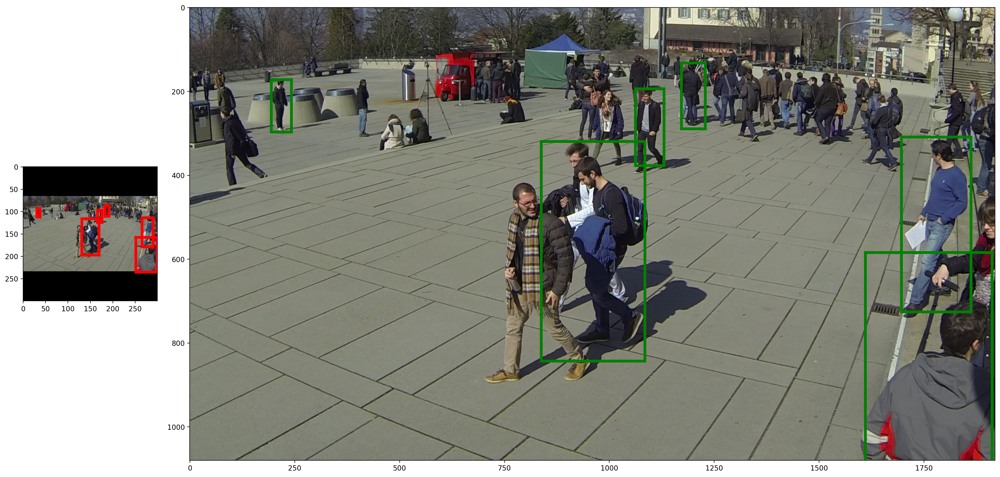

In [22]:
# ------------Initialize SSD300 model --------------------------------------
GLOBAL_SSD = SSD300('person') #Initialize SSD300 model

# ------------Open Video Stream --------------------------------------------
video = video_stream (video_file)
video.set_skip (n=15)

next_frame = video.next()
file_name, next_frame_300 = video.resize_save_frame (frame_dir, 300, 300) # save a reduced sized frame in a file in frame_dir to be read in
#---------------------------------------------------------------------
# detect people in the reduced frame and resize the bbox to original resolution
bboxes = GLOBAL_SSD.compute_bboxes(file_name)
bboxes.keep_tall_aspect ()  # bboxes of persons in the 300 by 300 sized image

#------------------------display-----------------------------------------------
widths = [2, 12]
heights = [1]
gs_kw = dict(width_ratios=widths, height_ratios=heights)
fig, ax = plt.subplots (1, 2, figsize =(20, 20), dpi = 200, constrained_layout=True, gridspec_kw=gs_kw,)

#-------------------------------------------
bboxes.resize_bboxes((300, 300)) # bbox coordinates range between 0 and 1, rescale them to original image coordinates.
#-------------------------------------------

bboxes.draw (ax[0], next_frame_300, 'r')

#-------------------------------------------
bboxes.resize_bboxes(next_frame.shape[0:2]) # bbox coordinates range between 0 and 1, rescale them to original image coordinates.
#-------------------------------------------

bboxes.draw (ax[1], next_frame, 'g')

video.close ()

# A simple video tracker

A straightforward idea for tracking

1. previous_bbox <-- Bounding box of person to be tracked in frame 1
2. for frame 2 to n do
>> 1. bbox_list <-- detect all persons in current frame
>> 2. current_bbox <-- find entry in bbox_list that is **most overlapping/similar** with previous_bbox
>> 3. previous_bbox <-- current_bbox

For coding ease, we can detect all persons in all video frames using SSD300.

We have to decide on the most overlapping logic
* Intersection over Union (Jaccard index or IOU measure)
* https://pytorch.org/vision/main/generated/torchvision.ops.box_iou.html

Consecutive bboxes might not overlap when the motion is significant, in which case we will need a similarity measure of the appearance of the person inside in the bbox.
* use color histogram-based similarity measure

## Code: Version 1- `video_tracker_IOU`

* Study how the bbox of the person is tracked through the frames (every 15th frame).

* The tracked IOUs are thresholded at 0.2. They are shown on the figure title for the corresponding plot. Notice how the IOU come close to 0.2 for some frames.

* Note how some overlapping persons are not detected.

* Notice also bbounding boxes are missing for some frames for some persons.


IOU: [[0.   0.01 0.   0.   0.   0.29]]
IOU: [[0.   0.   0.   0.   0.5  0.   0.19 0.  ]]
IOU: [[0.   0.   0.03 0.   0.   0.   0.   0.34 0.   0.12]]
IOU: [[0.   0.   0.   0.   0.29 0.19]]
IOU: [[0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.22 0.39]]
IOU: [[0.   0.   0.   0.   0.   0.   0.   0.44 0.29]]
IOU: [[0.   0.1  0.   0.   0.   0.   0.   0.28]]
IOU: [[0.  0.  0.  0.  0.  0.  0.  0.  0.4 0.  0. ]]
IOU: [[0.  0.  0.  0.  0.  0.  0.2]]


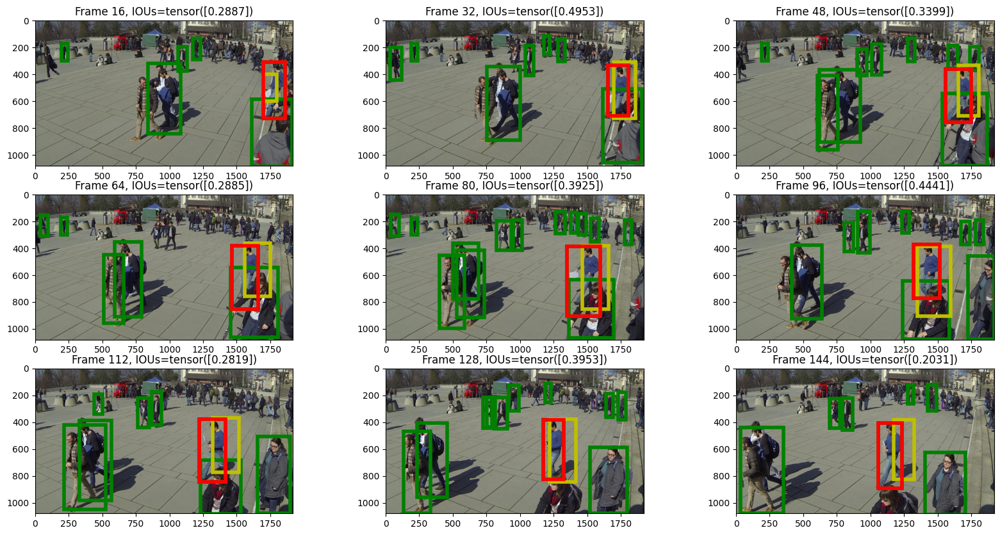

In [23]:
import torchvision

# ------------Initialize SSD300 model --------------------------------------
if 'GLOBAL_SSD' not in locals():
    GLOBAL_SSD = SSD300('person') #Initialize SSD300 model


def video_tracker_IOU (prev_bboxes, video_file, frame_dir, axs, num_frames=10, skip=15) :
    '''
    returns [track_x, track_y] storing the x and y location of the center of the bbox
    '''
    # ------------Open Video Stream --------------------------------------------
    video = video_stream (video_file)
    video.set_skip (n=skip)

    # -----look through frames--------------

    for i in range (num_frames) :
        next_frame = video.next()
        file_name, next_frame_300 = video.resize_save_frame (frame_dir, 300, 300) # save a reduced sized frame in a file in frame_dir to be read in
        #---------------------------------------------------------------------
        # detect people in the reduced frame and resize the bbox to original resolution
        bboxes = GLOBAL_SSD.compute_bboxes(file_name)
        bboxes.keep_tall_aspect ()  # bboxes of persons in the 300 by 300 sized image
        bboxes.resize_bboxes(next_frame.shape[0:2]) # bbox coordinates range between 0 and 1, rescale them to original image coordinates.

        #------------Match bounding box across frames using IOU------------------------
        matched_bboxes = bounding_boxes ()
        matches, ious = bboxes.find_matching_bbox (prev_bboxes.get_corners_rep(), iou_th=0.2)
        matched_bboxes.set_corners_rep (matches)

        #------------------------display-----------------------------------------------
        #ax = plt.subplot(int(num_frames/3+1), 3, i+1)
        ax = axs.ravel()[i] #"ravel" flattens the numpy array (axs is a 2D array of plots) without making a copy
        ax.set_title ('Frame {}, IOUs={}'.format(video.frame_number (), ious))
        bboxes.draw (ax, next_frame, 'g')
        prev_bboxes.draw (ax, [], 'y')
        matched_bboxes.draw (ax, [], 'r')
        prev_bboxes = matched_bboxes
#--------------------------------------------------------------------------------------------
video_file = data_dir+'Wildtrack/C1/cam1.mp4'
frame_dir = data_dir+'Wildtrack/C1/'
num_frames_to_track = 9

start_bbox = bounding_boxes ()
start_bbox.set_corners_rep (np.array([[[1700], [400], [1800], [600]]]))

fig, axs = plt.subplots(int(num_frames_to_track/3), 3)
fig.set_size_inches(20, 10)

video_tracker_IOU (start_bbox, video_file, frame_dir, axs, num_frames=num_frames_to_track, skip=15);


# Kalman video tracking of bounding boxes

* Bounding boxes parameterization can be done in many different ways

* two corners: $(x_1, y_1, x_2, y_2)$. Output of SSD300 is in this format

* center pixel of the box, width, and height: ($c_x$, $c_y$, width, height). This is the representation we will use to track as it nicely **decouples** the location aspect of the bounding box in the image with the size of the box.



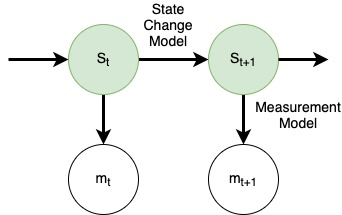

This is the state model we use for Kalman tracking.

* It consists of the states $\mathbf{s}_t$, which we do not directly know. We can only make observations or measurements $\mathbf{m}_t$ as some aspects of the states.
    * For instance, if we consider the problem of tracking persons in the video, our state could be the location of the center of the bounding box ($c_x, c_y$), dimensions of the bounding box (width, height), the velocity of the center of the box $(v_x, v_y)$, and the acceleration of movement of the center of the box $(a_x, a_y$) through the frames: $\mathbf{s}_t=[c_x, c_y, v_x, v_y, a_x, a_y, w, h]^T$
    * While we can estimate the parameters of the bounding box, i.e., it is center ($c_x, c_y$) and dimensions $(w, h)$, we cannot make measurements of the velocity or the acceleration from an image taken at a particular time.

* The states $\mathbf{s}_t$ are modeled to be a Gaussian random variable with mean, denoted by $\mathbf{\hat{s}}_t$, and a covariance $\mathbf{P}_t^{8 \times 8}$. At each instant, we will have to **estimate** the mean and covariance of the state. Note that the mean and the covariance completely specify a Gaussian random variable. The larger the entries of the covariance matrix, the larger the uncertainty in the corresponding state's estimate. The diagonal entries of $\mathbf{P}$ store the variance of the individual components, and the off-diagonal entries are the cross-covariances. Note that the covariance matrix is **symmetric**.

\begin{equation}
\mathbf{P}_t =
\begin{bmatrix}
\sigma_{c_x}^2 & \sigma_{c_x c_y} & \sigma_{c_x v_x} & \sigma_{c_x v_y} & \sigma_{c_x a_x} & \sigma_{c_x a_y} & \sigma_{c_x w} & \sigma_{c_x h}\\
\sigma_{c_y c_x} & \sigma_{c_y}^2 & \sigma_{c_y v_x} & \sigma_{c_y v_y} & \sigma_{c_y a_x} & \sigma_{c_y a_y} & \sigma_{c_y w} & \sigma_{c_y h}\\
\vdots   & \vdots & \vdots   & \vdots & \vdots   & \vdots & \vdots   & \vdots \\
\sigma_{h c_x} & \sigma_{h c_y} & \sigma_{h v_x} & \sigma_{h v_y} & \sigma_{h a_x} & \sigma_{h a_y} & \sigma_{h w} & \sigma_{h}^2\\
\end{bmatrix}
\end{equation}

* The **measurement model** directly relates the states with the measurement. We use a **linear** model with additive Gaussian noise, represented by the zero-mean random vector, $\mathbf{w}$. More complicated non-linear models are possible; however, just a linear model has broad applicability.

\begin{eqnarray}
\mathbf{m}_t & = & \mathbf{H} \mathbf{s}_t + \mathbf{w} \\
\begin{bmatrix}
m_x \\ m_y \\ m_w \\ m_h
\end{bmatrix} & = &
\begin{bmatrix}
1 & 0 & 0 & 0 & 0 & 0 & 0 & 0 \\
0 & 1 & 0 & 0 & 0 & 0 & 0 & 0 \\
0 & 0 & 0 & 0 & 0 & 0 & 1 & 0 \\
0 & 0 & 0 & 0 & 0 & 0 & 0 & 1 \\
\end{bmatrix}
\begin{bmatrix}
c_x \\ c_y \\ v_x \\  v_y\\  a_x\\ a_y \\ w \\ h
\end{bmatrix} +
\begin{bmatrix}
w_0 \\ w_1 \\ w_2 \\ w_3
\end{bmatrix}
\end{eqnarray}


* The state transition model specifies how the state evolves. Again, we use a **linear** model with additive, zero-mean Gaussian noise, represented in the following equation by $\mathbf{n}$.

\begin{eqnarray}
\mathbf{s}_{t+1} & = &  \mathbf{A} \mathbf{s}_{t} + \mathbf{n}\\
\begin{bmatrix}
        c_x \\ c_y \\ v_x \\ v_y \\ a_x \\ a_y \\ w \\ h
\end{bmatrix}_{t+1} & = &
\begin{bmatrix}
1 & 0 & 1 & 0 & 0 & 0 & 0 & 0\\
0 & 1 & 0 & 1 & 0 & 0 & 0 & 0\\
0 & 0 & 1 & 0 & 1 & 0 & 0 & 0\\
0 & 0 & 0 & 1 & 0 & 1 & 0 & 0\\
0 & 0 & 0 & 0 & 1 & 0 & 0 & 0\\
0 & 0 & 0 & 0 & 0 & 1 & 0 & 0\\
0 & 0 & 0 & 0 & 0 & 0 & 1 & 0\\
0 & 0 & 0 & 0 & 0 & 0 & 0 & 1
\end{bmatrix}
\begin{bmatrix}
c_x \\ c_y \\ v_x \\ v_y \\ a_x \\ a_y \\ w \\ h
\end{bmatrix}_{t} +
\begin{bmatrix}
n_0 \\ n_1 \\ n_2 \\ n_3 \\ n_4 \\ n_5 \\ n_6 \\ n_7
\end{bmatrix}
\end{eqnarray}

* We have two noise models to specify, $\mathbf{w}$, and $\mathbf{n}$, which we model as zero-mean Gaussian noise with covariance $\mathbf{R}^{4 \times 4}$ and $\mathbf{Q}^{8 \times 8}$ respectively. Typically these covariance matrices are chosen to be diagonal, i.e., the noise components are uncorrelated. For each matrix, even the diagonal values are the same.

\begin{eqnarray}
\mathbf{R}^{4 \times 4} & = & r \mathbf{I}^{4 \times 4} \\
\mathbf{Q}^{8 \times 8} & = & q \mathbf{I}^{8 \times 8} \\
\end{eqnarray}


## Code: Class `Kalman_track`

In [24]:
# The code works for multiple (n) tracked entities, in batch mode. This can track multiple objects.
import copy

class Kalman_track:
    # class for bounding box tracking, which is specified in cxcywh format -- center(cx, cy) and dimensions (width, height)

    def __init__(self, type, batch_size, measurement_function, model_cov_q=25, measurement_cov_r=25):
        # 1.type -- 'constant acceleration', 'constant velocity', 'stationary'
        # 2.batch_size -- number of simultaneous objects tracked.
        # 3.User-specified measurement function accepts the following two arguments
        #   (1. predicted state vector -- only the portion corresponding to the measured value,
        #    2. predicted state covariance -- for only for the measured parts of the state vector)

        if type == 'constant_acceleration' :
            # the center (cx, cy) moves with constant acceleration, but the width and height is stationary
            self.state_size = 8  #(cx, cy, vx, vy, ax, ay, width, height)

            # A -- #states by #states 2D state model matrix,
            # used to change all the state vectors -- the matrix is the same for all state vector in a batch
            self.A = np.array([ [1, 0, 1, 0, 0, 0, 0, 0],  # x + vx constant acceleration model for (x, y)
                                [0, 1, 0, 1, 0, 0, 0, 0],  # y + vy
                                [0, 0, 1, 0, 1, 0, 0, 0],  # vx + ax
                                [0, 0, 0, 1, 0, 1, 0, 0],  # vy + ay
                                [0, 0, 0, 0, 1, 0, 0, 0],    #ax --
                                [0, 0, 0, 0, 0, 1, 0, 0],    #ay
                                [0, 0, 0, 0, 0, 0, 1, 0],   # width  -- stationary model for width and height
                                [0, 0, 0, 0, 0, 0, 0, 1]])  # height # state model

            # measurement model -- can only directly measure bounding box parameters, cx, cy, width, height
            self.H = np.array([[1, 0, 0, 0, 0, 0, 0, 0],
                               [0, 1, 0, 0, 0, 0, 0, 0],
                               [0, 0, 0, 0, 0, 0, 1, 0],
                               [0, 0, 0, 0, 0, 0, 0, 1]])

        if type == 'constant velocity' :
            # the center moves with constant velocity, but the width and height is stationary
            self.state_size = 6  #(cx, cy, vx, vy, width, height)
            # state model -- constant velocity model for (cx cy) and stationary for (width, height)
            A = np.array([[1, 0, 1, 0, 0, 0], #x + vx
                          [0, 1, 0, 1, 0, 0], #y+  vy
                          [0, 0, 1, 0, 0, 0],  #vx  -- constant velocity
                          [0, 0, 0, 1, 0, 0],  #vy
                          [0, 0, 0, 0, 1, 0],  #width -- constant width
                          [0, 0, 0, 0, 0, 1]]) #height -- constant height

            # measurement model -- can only directly measure bounding box parameters, cx, cy, width, height
            H = np.array([[1, 0, 0, 0, 0, 0],
                          [0, 1, 0, 0, 0, 0],
                          [0, 0, 0, 0, 1, 0],
                          [0, 0, 0, 0, 0, 1]])  # measurement model -- can directly measure only the location

        if type == 'stationary' :
            self.state_size = 4  #(cx, cy, width, height)

            # A -- #states by #states 2D state model matrix,
            # used to change all the state vectors -- the matrix is the same for all state vector in a batch
            self.A = np.eye(4)

            # measurement model -- can directly measure only the location
            self.H = np.eye(4)

        #-----------------------------------------------------------------------
        self.batch_size = batch_size
        self.meas_size = 4
        # bounding box tracking -- center(cx, cy) and dimention (width, height)
        self.measurement_function = measurement_function

        # s_hat_t -- batch_size by #state by 1 matrix, state tensor
        self.s_hat_t = np.zeros ((self.batch_size, self.state_size, 1))

        # P_t -- batch_size by #states by #states 3D tensor,  covariance matrices of the state tensor
        self.P_t = np.eye(self.state_size) # state covariance (error) # 5 pixels location error
        self.P_t = self.P_t.reshape((1, self.state_size, self.state_size))
        self.P_t = self.P_t.repeat(batch_size, 0) # batch_size by 8 by 8 - batch of n identity matrices

        # prespecified model covariance (error) #states by #states 2D model covariance matrix
        # the covariance is the same of all state vectors in a batch
        self.Q = model_cov_q*np.eye(self.state_size)

        self.R = measurement_cov_r*np.eye(self.meas_size ) # measurement covariance (error)
        self.R = self.R.reshape((1, self.meas_size, self.meas_size))
        self.R = self.R.repeat(batch_size,0) # batch_size by meas_size  by meas_size  - batch of n identity matrices

        # starting Kalman gain matrix
        self.K = np.zeros([self.state_size, self.meas_size])

        self.s_minus_next  = [] # intermediate state tensor
        self.P_minus_next  = [] # intermediate state covariance

        # store measurement batch vectors.
        self.measurement = np.zeros([self.batch_size, self.meas_size, 1])

        # Variables to store the (x, y) locations of the tracked objects. It is used for
        # displaying the tracks on the image. It uses of list of lists structure
        track_x = [[]]; track_y = [[]]
        for i in range (self.batch_size) :
            track_x.append([]); track_y.append([]);

        self.state_history = [[self.s_hat_t, self.P_t, self.K, #Kalman gain matrix
                               [], [], [],  # will store the predicted, matched, and current bboxes
                               track_x, track_y]]

    #----------------------------------------------------------------------------
    def forward_update (self) :
        self.s_minus_next = self.A @ self.s_hat_t
        self.P_minus_next = (self.A @ self.P_t) @ np.transpose(self.A) + self.Q

        # note the use of advanced numpy indexing np.ix_ -- look up what it does
        #print('s_minus_next', s_minus_next.shape, 'P_minus_next', P_minus_next.shape)
    #----------------------------------------------------------------------------
    def compute_kalman_gain (self) :
        self.K = (self.P_minus_next @
                  np.transpose(self.H) @
                  (np.linalg.inv(self.H @ (self.P_minus_next @ np.transpose(self.H)) +
                                 self.R)))
        #print('K', K.shape)
    #----------------------------------------------------------------------------
    def measurement_update (self) :
        #print('\ns_minus_next', self.s_minus_next.shape)
        #print('K', self.K.shape)
        #print('measurement', self.measurement.shape)
        #print('H', self.H.shape)

        self.s_hat_next = self.s_minus_next + self.K @ (self.measurement - self.H @ self.s_minus_next)
        self.P_next = (np.eye(self.K.shape[1]) - self.K @ self.H) @ self.P_minus_next

        # for bboxes for which we had no measurement, we set the next state to
        # just based on the state model estimates
        index = (self.measurement[:,2,0] < 0)  # index of the bboxes that were NOT matched.
        #print (index, self.measurement)
        # recall that using bbox matching, we store [-100, -100, -100, -100] for the bbox that
        # had no match
        self.s_hat_next[index,:,:] = self.s_minus_next[index,:,:]
        self.P_next[index,:,:] = self.P_minus_next[index,:,:]

    #----------------------------------------------------------------------------
    def step (self, ROI) :
        # performs one cycle through the full Kalman updating process
        # update tracks only with the region of interest (ROI) specified as a rectangular
        # region in xyxy (corners) format -- just plain numpy array [x1, y1, x2, y2]
        self.update_indx = np.logical_and (np.logical_and((self.s_hat_t[:,0,0] > ROI[0]),
                                                          (self.s_hat_t[:,1,0] > ROI[1])),
                                           np.logical_and((self.s_hat_t[:,0,0] < ROI[2]),
                                                          (self.s_hat_t[:,1,0] < ROI[3])))

        #print('\n',self.s_hat_t[:,0:2,0])
        #print(self.update_indx)
        # ----- Run forward model ---------------
        self.forward_update ()
        #-------Perform Measurement ---------
        self.predicted_boxes = bounding_boxes (self.H  @ self.s_minus_next, 'cxcywh')
        self.measurement = self.measurement_function (self.predicted_boxes, # select only the measured part of the state vector
                                                      self.H @ (self.P_t @ np.transpose(self.H)),
                                                      # above is the cov only for the measured parts of the state vector: i.e. relevant part of intermediate_state_covariance_P,
                                                      )
        self.matched_bboxes = bounding_boxes (self.measurement, 'cxcywh')
        #-------Compute Kalman Gain ------------
        self.compute_kalman_gain ()

        #-------Measurement Update---------------
        self.measurement_update ()

        #-------Update states---------------------
        self.s_hat_t[self.update_indx] = self.s_hat_next[self.update_indx]
        self.P_t[np.ix_(self.update_indx,self.update_indx)] = self.P_next [np.ix_(self.update_indx,self.update_indx)]
        self.current_boxes = bounding_boxes (self.H  @ self.s_hat_t, 'cxcywh')

        #-------Store history--------------------------
        track_x = copy.deepcopy (self.state_history[-1][-2])
        track_y = copy.deepcopy (self.state_history[-1][-1])

        for j in range (self.batch_size) :
            track_x[j].append (self.s_hat_t[j,0,0])  # note the use of 3 indices since we have a n_entities by 4 by 1 array
            track_y[j].append (self.s_hat_t[j,1,0])

        self.state_history.append([self.s_hat_t, self.P_t, self.K,
                                   self.predicted_boxes, self.matched_bboxes, self.current_boxes,
                                   track_x, track_y])

        #print('Measurement:\n {}\n Next State:\n{} \nKalman gain:\n{}'.format(self.measurement,
        #                                                                      self.s_hat_t,
        #                                                                      self.K))
    #----------------------------------------------------------------------------
    def initialize_state_from_bbox_cxcywh (self, bboxes) :
        # Initialize state from  a bbox specification [cx, cy, width, height]
        # state = [cx, cy, 0, 0, 0, 0, width, height]
        self.s_hat_t  = np.transpose(self.H) @ bboxes

    #----------------------------------------------------------------------------
    def get_history (self) :
        return (self.state_history)



## Code: `measure_bbox_in_next_frame`

In [25]:
def measure_bbox_in_next_frame (pred_bboxes, predicted_cov) :
      # pred_bbox -- batch_size by [cx, cy, width, height] by 1 -- bbox of object in next frame
      # predicted_cov -- batch_size by  n_state by n_state covariance of prediction -- can be used to restrict search in next frame      #
      # returns
      # measurement_m:  batch_size by [cx, cy, width, height] by 1 -- new bboxes

    # Assumes that  the following GLOBAL variables are set:
    global GLOBAL_video, GLOBAL_SSD


    # Read in next frame after skipping the specified number of frames
    next_frame = GLOBAL_video.next ()
    #-------------------------Prepare frame for object detection by SSD300------------------------
    # The deep learning network SSD300 accepts images of size 300 by 300
    # Resize to 300 by 300 without changing aspect ratio of the image. Using black band as fillers
    file_name, _ = GLOBAL_video.resize_save_frame (frame_dir, 300, 300) # save a reduced sized frame in a file in frame_dir to be read in

    #---------------------------------------------------------------------
    # detect people in the reduced frame and resize the bbox to original resolution
    bboxes = GLOBAL_SSD.compute_bboxes(file_name)
    bboxes.keep_tall_aspect ()  # bboxes of persons in the 300 by 300 sized image
    bboxes.resize_bboxes(next_frame.shape[0:2]) # bbox coordinates range between 0 and 1, rescale them to original image coordinates.


    #------------Match bounding box across frames using IOU------------------------
    measurement_m, ious = bboxes.find_matching_bbox (pred_bboxes.get_corners_rep(), iou_th = 0.2)

    # change from 'xyxy' to 'cxcywh' format
    matched_bboxes = bounding_boxes (measurement_m, 'xyxy')
    measurement_m = matched_bboxes.get_center_rep () #'cxcywh' format

    return (measurement_m)


## Code: Version 2 - `Kalman_video_tracker_IOU`

Using cache found in /root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub
Using cache found in /root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub


Computing on:  cuda:0
IOU: [[0.   0.   0.   0.37 0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.1  0.   0.79 0.  ]
 [0.   0.89 0.   0.   0.   0.   0.   0.  ]
 [0.55 0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.03 0.   0.   0.   0.46]
 [0.   0.   0.   0.   0.5  0.   0.19 0.  ]]
IOU: [[0.   0.   0.   0.   0.   0.29 0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.15 0.   0.67]
 [0.92 0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.04 0.02 0.29 0.   0.   0.  ]
 [0.   0.   0.04 0.   0.   0.   0.   0.25 0.   0.13]]
IOU: [[0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.16 0.65]
 [0.95 0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.07 0.53 0.   0.  ]
 [0.   0.   0.   0.   0.29 0.17]]
IOU: [[0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.16 0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.64 0.3 ]
 [0.   0.93 0.   0.   0.   0.   0. 

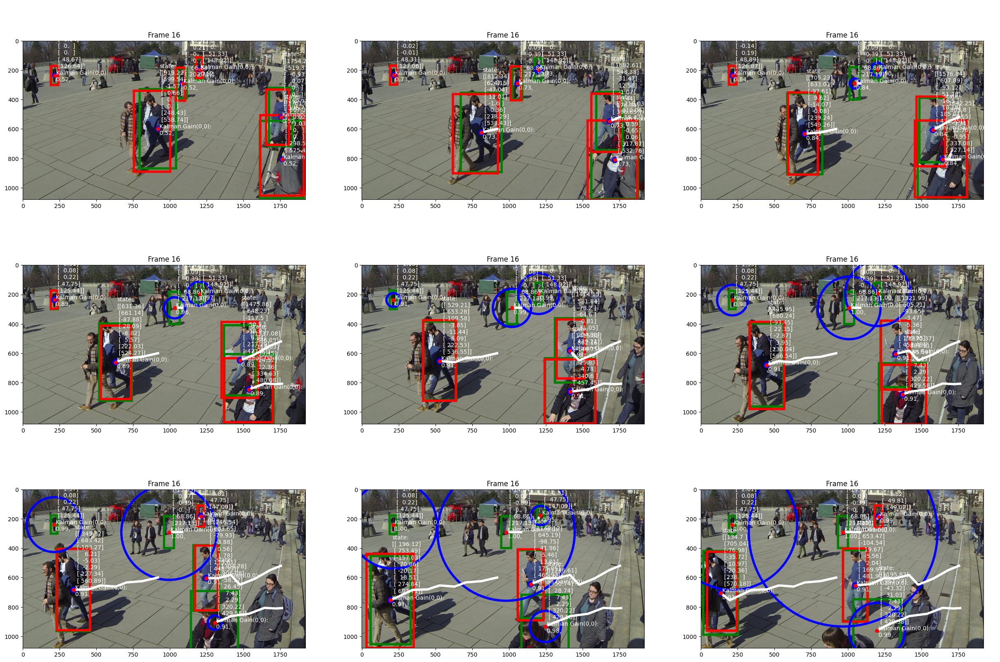

<Figure size 6000x6000 with 0 Axes>

In [26]:
import torchvision
from matplotlib import pyplot as plt
import matplotlib.patches as patches

def Kalman_video_tracker_IOU (video_file, frame_dir, axs, num_frames=10, skip_frames = 15) :
    '''
    Tracks all the bounding boxes of "persons" found in the first frame.
    '''
    global GLOBAL_video, GLOBAL_SSD

    np.set_printoptions(precision=2, suppress=True)

    # ------------Initialize SSD300 model --------------------------------------
    if 'GLOBAL_SSD' not in locals():
        GLOBAL_SSD = SSD300('person') #Initialize SSD300 model

    # ------------Open Video Stream --------------------------------------------
    GLOBAL_video = video_stream (video_file)
    GLOBAL_video.set_skip (skip_frames)

    # -------------INITIALIZE Kalman Tracks WITH bboxes from FIRST FRAME----------------------
    frame = GLOBAL_video.next ()
    file_name, _ = GLOBAL_video.resize_save_frame (frame_dir, 300, 300) # save a reduced sized frame in a file in frame_dir to be read in
    # detect people in the reduced frame and resize the bbox to original resolution
    bboxes = GLOBAL_SSD.compute_bboxes(file_name)
    bboxes.keep_tall_aspect ()  # bboxes of persons in the 300 by 300 sized image
    bboxes.resize_bboxes(frame.shape[0:2]) # bbox coordinates range between 0 and 1, rescale them to original image coordinates.

    Kalman = Kalman_track ('constant_acceleration', bboxes.count(), measure_bbox_in_next_frame,
                           model_cov_q=25, measurement_cov_r=25) #Instantiate Kalman Class
    Kalman.initialize_state_from_bbox_cxcywh (bboxes.get_center_rep())

    # -----track through the frames--------------
    plt.figure(figsize = (60, 60), dpi = 100)
    ROI = np.array([0,0,frame.shape[1], frame.shape[0]])
    #print(ROI)
    for i in range (num_frames) :

        Kalman.step (ROI)

        # VISUALIZE the track so far
        track_history = Kalman.get_history ()
        frame = GLOBAL_video.current_frame ()

        states, P, K, predicted_boxes, matched_bboxes, current_boxes, track_x, track_y = track_history[-1]
        # skip the first entry of the history, which is just initial conditions
        ax = axs.ravel()[i] #"ravel" flattens the numpy array (axs is a 2D array of plots) without making a copy
        ax.set_title ('Frame {}'.format(video.frame_number ()))

        current_boxes.draw (ax, frame, 'g')
        #predicted_boxes.draw (ax, [], 'y')
        matched_bboxes.draw (ax, [], 'r')

        for j in range(len(track_x)-1) :
            ax.plot(track_x[j], track_y[j], 'w', linewidth=4)
            # overlay a (pseudo) confidence ellipse that is proportional to the size of the bbox
            ax.plot(states[j,0], states[j,1], 'ro')
            ax.add_patch(confidence_ellipse(P[j,0:2,0:2], [states[j][0], states[j][1]], ax, n_std = 3, edgecolor='b', linewidth=4))
            ax.text(states[j,0]+10, states[j,1]+40, 'state:\n{}\nKalman Gain(0,0):\n{:3.2f}, '.format(states[j], K[j,0,0]), color='w')


    GLOBAL_video.close ()
    track_history = Kalman.get_history ()
    return(track_history)
    # -------------------- DISPLAY/VISUALIZE the tracking --------------------

#-------------------------------------------------------------------------------
video_file = data_dir+'Wildtrack/C1/cam1.mp4'
frame_dir = data_dir+'Wildtrack/C1/'
num_frames_to_track = 9
fig, axs = plt.subplots(int(num_frames_to_track/3), 3)

fig.set_size_inches(30, 20)

Kalman_video_tracker_IOU (video_file, frame_dir, axs, num_frames=num_frames_to_track, skip_frames=15);




#Assignment

* Why are the blue circles so large for some objects? Can you explain?

* How would you remove tracks of persons leaving the frame?

* What are some of the ways you can improve the "measurement" method?
    * https://docs.opencv.org/4.x/d4/dc6/tutorial_py_template_matching.html
    * https://docs.opencv.org/3.4/d8/dc8/tutorial_histogram_comparison.html
    

* How would you introduce new tracks of persons that appear in the middle of the video?


# Challenge

Can you read and understand the following paper? I am confident you will be able to do it based on what you have learned in this course.

A. Bewley, Z. Ge, L. Ott, F. Ramos and B. Upcroft, "Simple online and realtime tracking," 2016 IEEE International Conference on Image Processing (ICIP), 2016, pp. 3464-3468, doi: 10.1109/ICIP.2016.7533003


https://arxiv.org/abs/1602.00763